In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sb
import warnings
warnings.filterwarnings('ignore')
from scipy.stats import norm, boxcox
from scipy import stats
from collections import Counter
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import statsmodels.api as sm
import pickle as pk

In [17]:
data = pd.read_csv("used_device_data.csv")


In [18]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3454 entries, 0 to 3453
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   device_brand           3454 non-null   object 
 1   os                     3454 non-null   object 
 2   screen_size            3454 non-null   float64
 3   4g                     3454 non-null   object 
 4   5g                     3454 non-null   object 
 5   rear_camera_mp         3275 non-null   float64
 6   front_camera_mp        3452 non-null   float64
 7   internal_memory        3450 non-null   float64
 8   ram                    3450 non-null   float64
 9   battery                3448 non-null   float64
 10  weight                 3447 non-null   float64
 11  release_year           3454 non-null   int64  
 12  days_used              3454 non-null   int64  
 13  normalized_used_price  3454 non-null   float64
 14  normalized_new_price   3454 non-null   float64
dtypes: f

In [19]:
data.head()

,device_brand,os,screen_size,4g,5g,rear_camera_mp,front_camera_mp,internal_memory,ram,battery,weight,release_year,days_used,normalized_used_price,normalized_new_price
0,Honor,Android,14.50,yes,no,13.0,5.0,64.0,3.0,3020.0,146.0,2020,127,4.307572,4.715100
1,Honor,Android,17.30,yes,yes,13.0,16.0,128.0,8.0,4300.0,213.0,2020,325,5.162097,5.519018
2,Honor,Android,16.69,yes,yes,13.0,8.0,128.0,8.0,4200.0,213.0,2020,162,5.111084,5.884631
3,Honor,Android,25.50,yes,yes,13.0,8.0,64.0,6.0,7250.0,480.0,2020,345,5.135387,5.630961
4,Honor,Android,15.32,yes,no,13.0,8.0,64.0,3.0,5000.0,185.0,2020,293,4.389995,4.947837


In [20]:
categorical_data=pd.DataFrame(data[['device_brand', 'os','4g', '5g','rear_camera_mp','front_camera_mp','internal_memory','ram','battery','release_year','normalized_used_price','normalized_new_price']])

In [21]:
categorical_data.head()

,device_brand,os,4g,5g,rear_camera_mp,front_camera_mp,internal_memory,ram,battery,release_year,normalized_used_price,normalized_new_price
0,Honor,Android,yes,no,13.0,5.0,64.0,3.0,3020.0,2020,4.307572,4.715100
1,Honor,Android,yes,yes,13.0,16.0,128.0,8.0,4300.0,2020,5.162097,5.519018
2,Honor,Android,yes,yes,13.0,8.0,128.0,8.0,4200.0,2020,5.111084,5.884631
3,Honor,Android,yes,yes,13.0,8.0,64.0,6.0,7250.0,2020,5.135387,5.630961
4,Honor,Android,yes,no,13.0,8.0,64.0,3.0,5000.0,2020,4.389995,4.947837


Number of Primary Types in device_brand: 34
Number of Primary Types in os: 4
Number of Primary Types in 4g: 2
Number of Primary Types in 5g: 2
Number of Primary Types in rear_camera_mp: 42
Number of Primary Types in front_camera_mp: 38
Number of Primary Types in internal_memory: 16
Number of Primary Types in ram: 13
Number of Primary Types in battery: 325
Number of Primary Types in release_year: 8
Number of Primary Types in normalized_used_price: 3094
Number of Primary Types in normalized_new_price: 2988


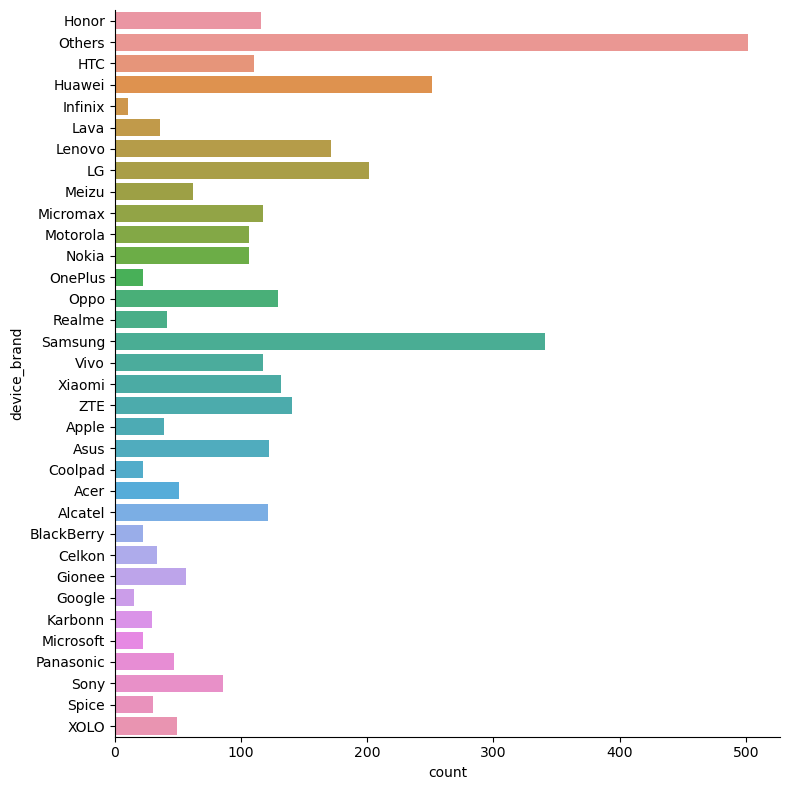

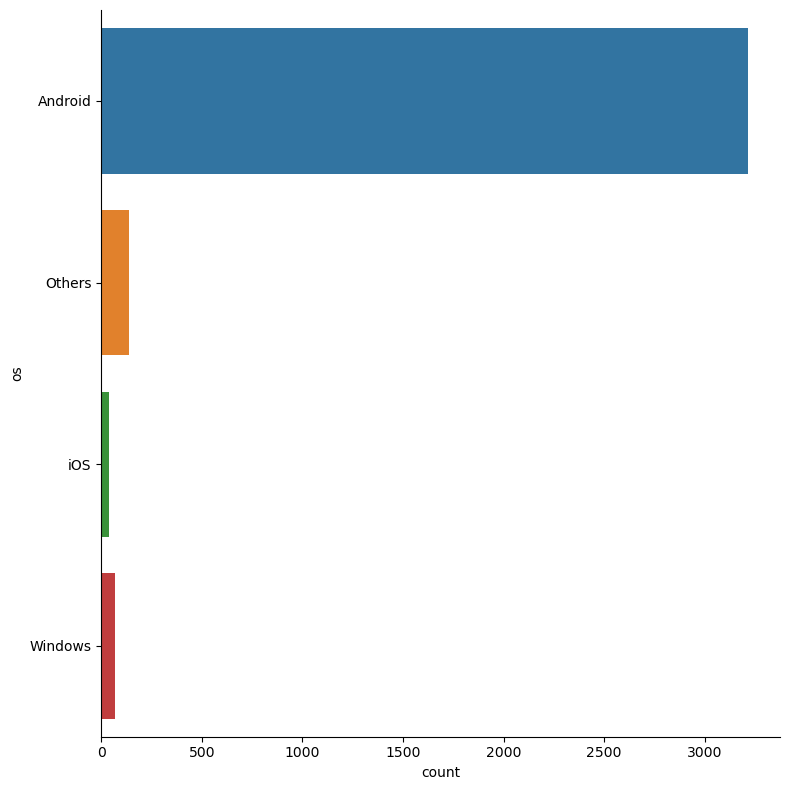

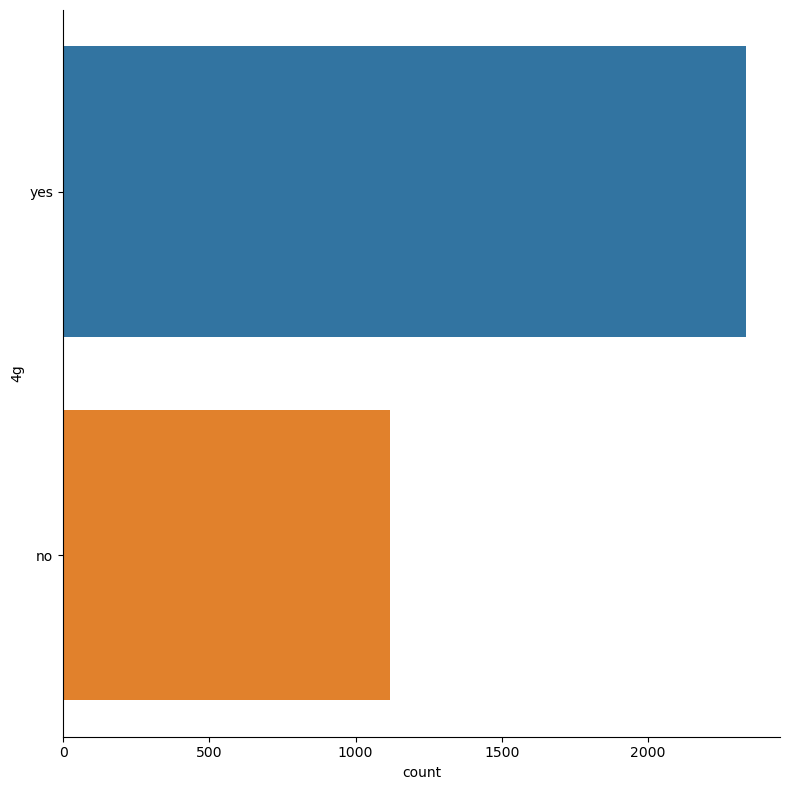

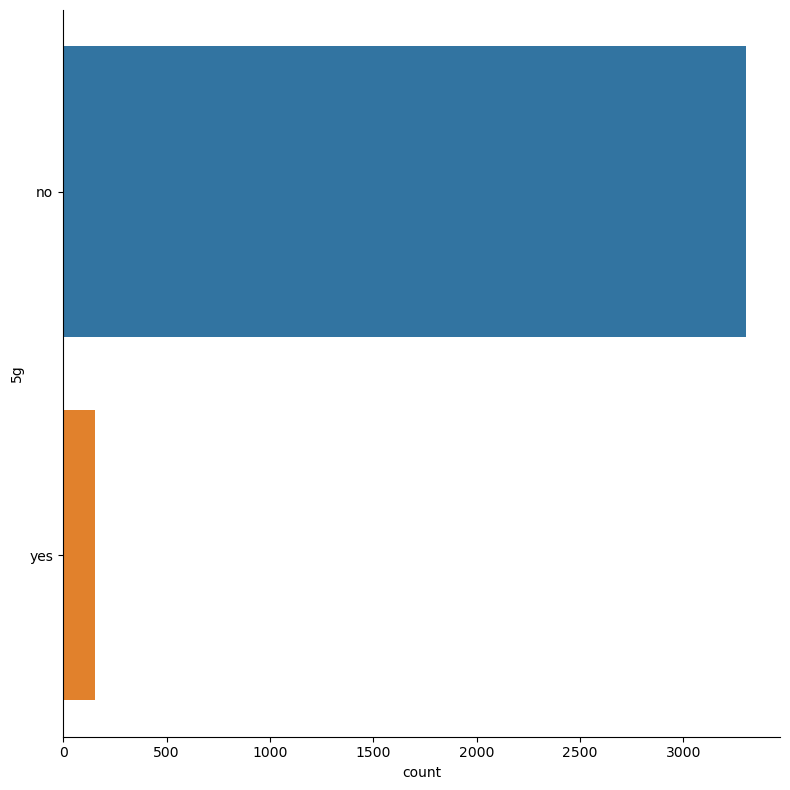

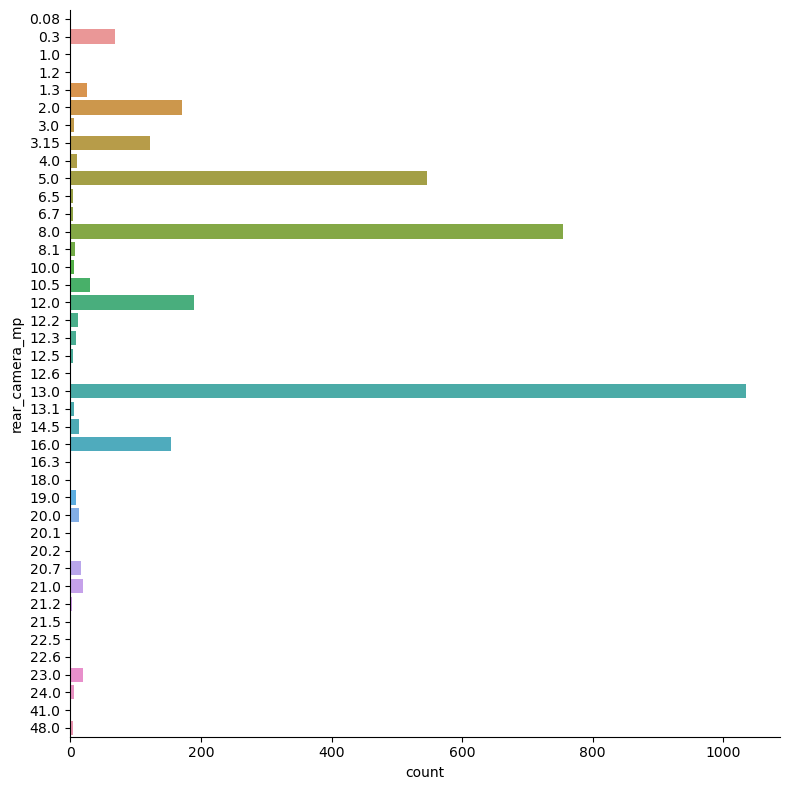

...

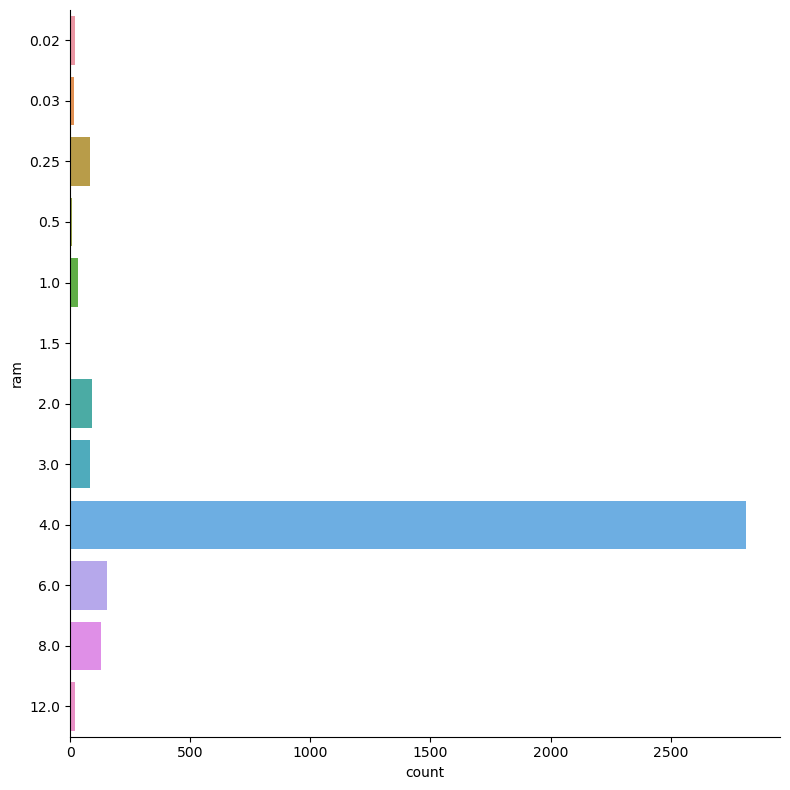

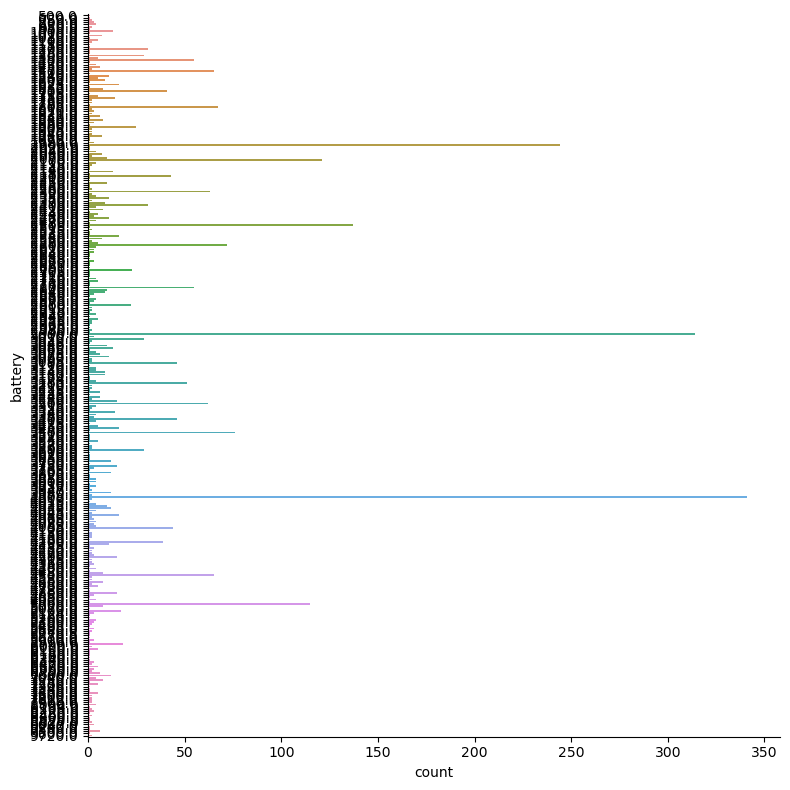

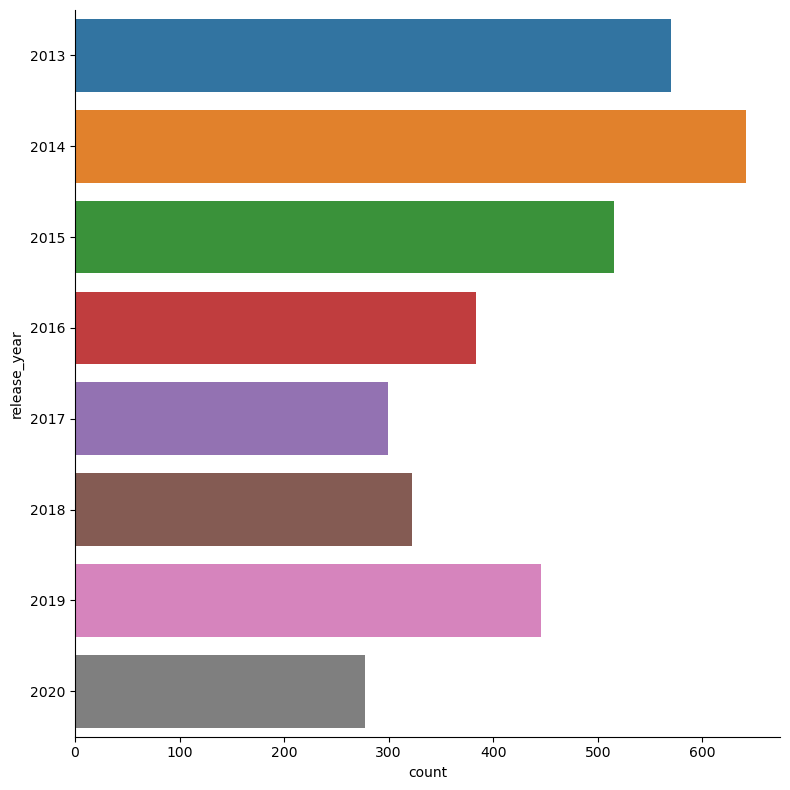

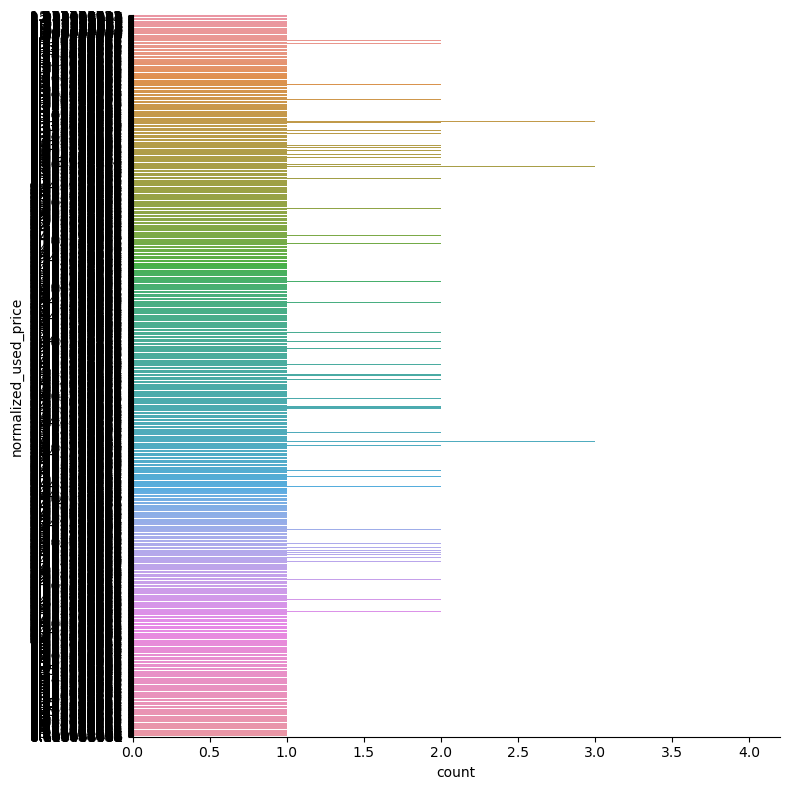

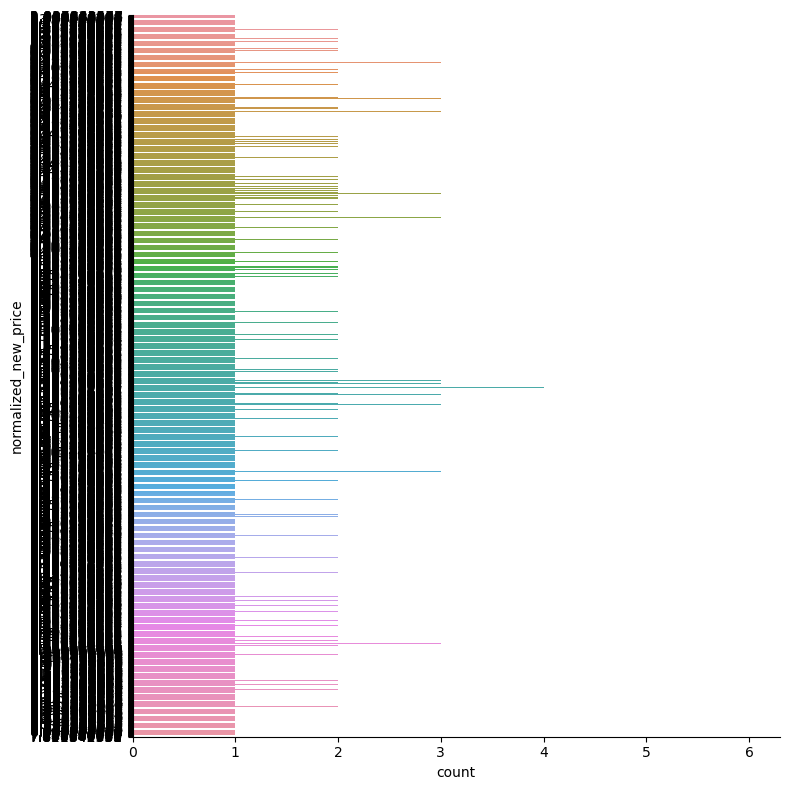

In [22]:
for var in categorical_data:
    # Primary Types in the Dataset
    print(f"Number of Primary Types in {var}:", len(categorical_data[var].unique()))
    # Pokemons of each Primary Type
    #print(categorical_data[var].value_counts())
    sb.catplot(y = var, data = categorical_data, kind = "count", height = 8)
    #sb.catplot(data=categorical_data, x=var, y="SalePrice", kind="box")
   

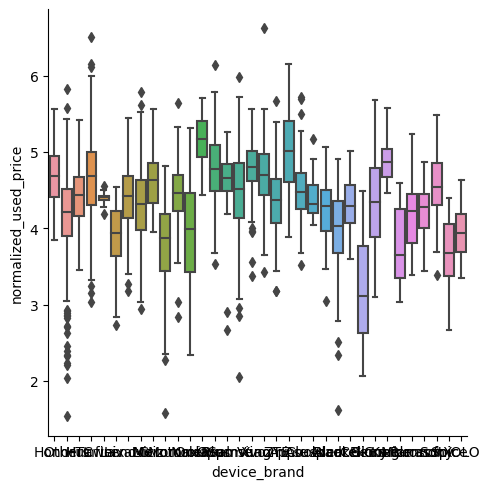

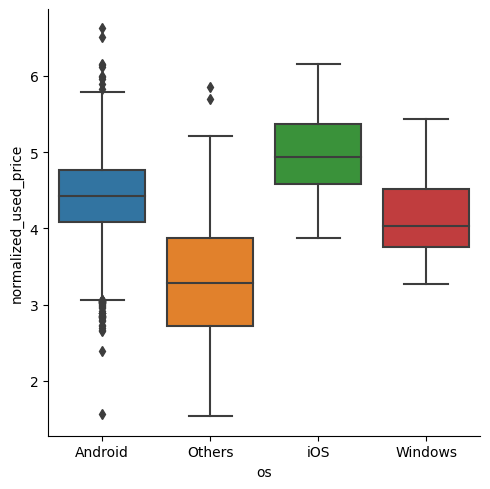

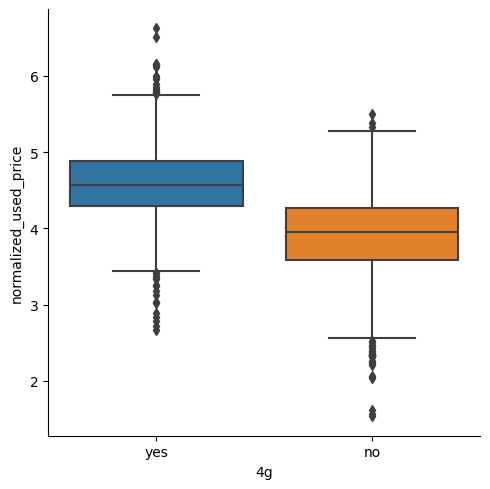

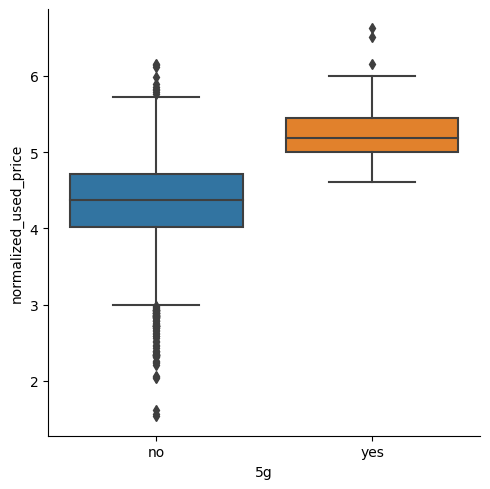

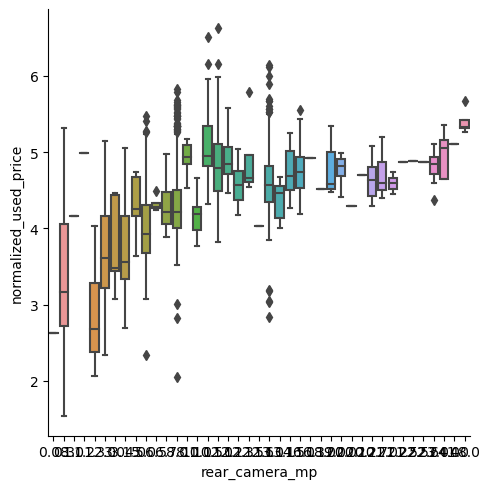

...

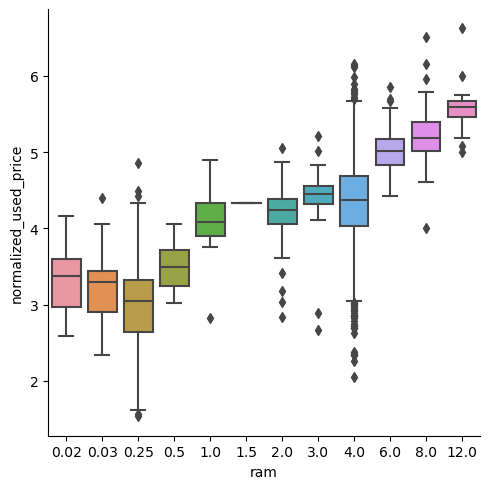

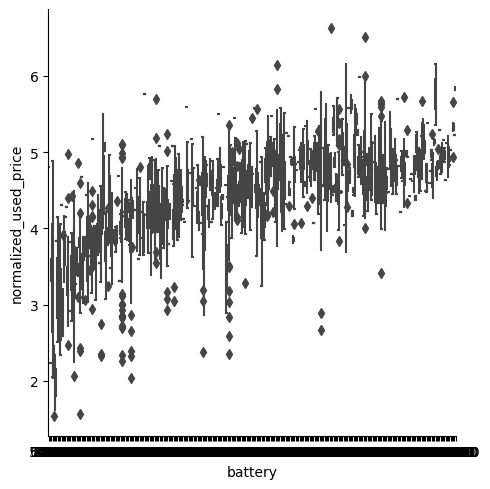

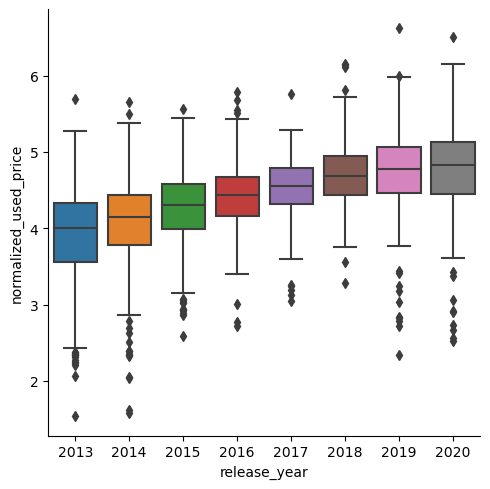

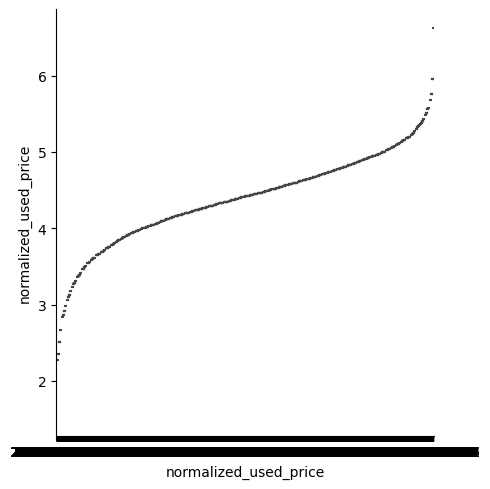

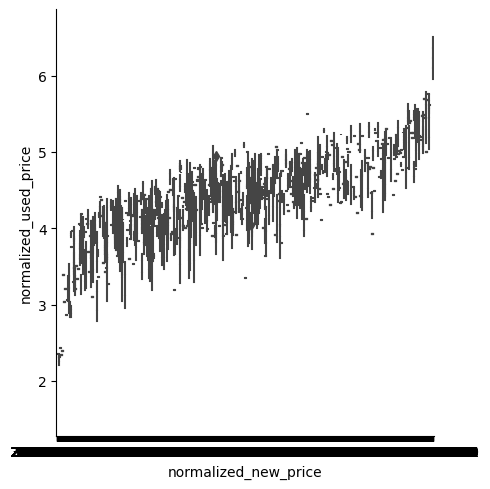

In [23]:
 for var in categorical_data:
    sb.catplot(data=categorical_data, x=var, y="normalized_used_price", kind="box")

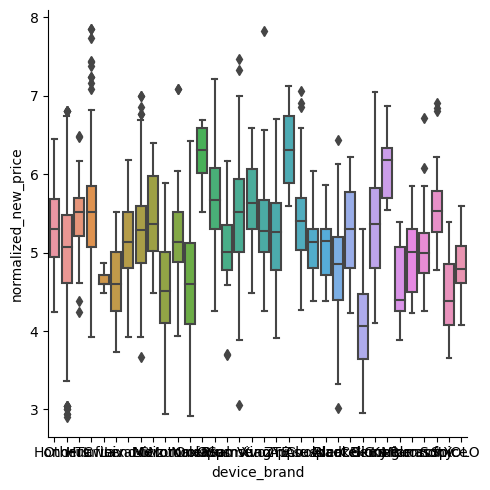

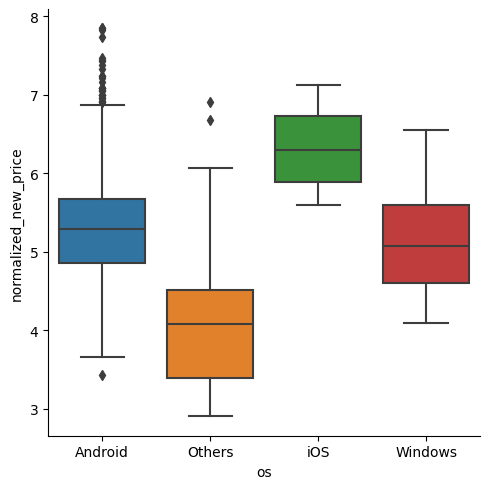

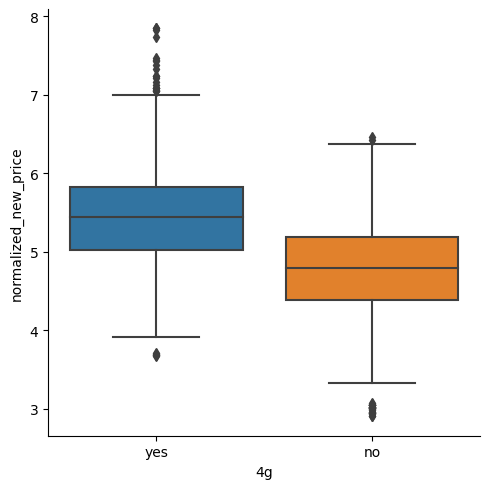

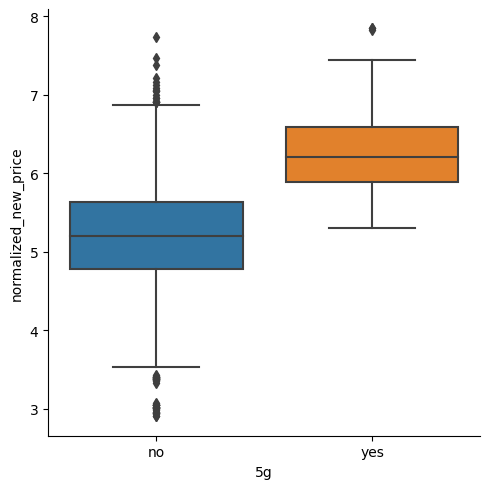

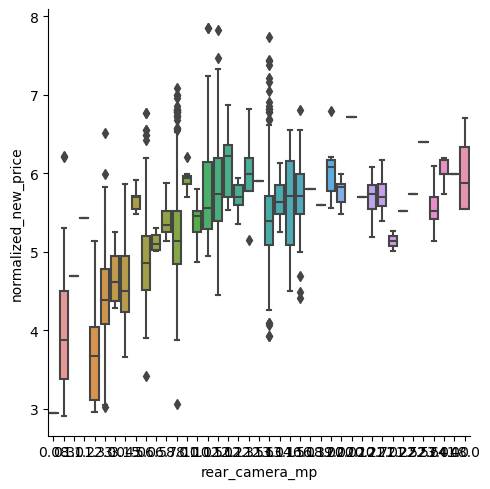

...

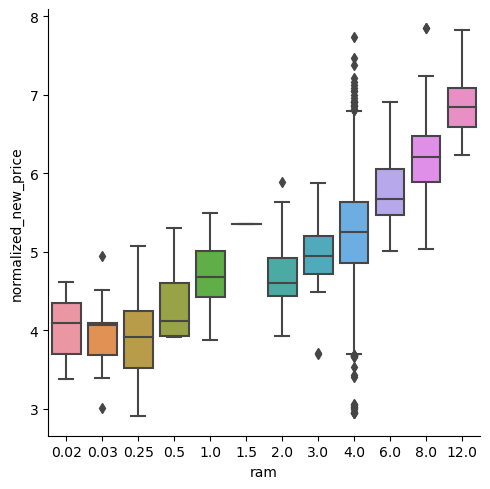

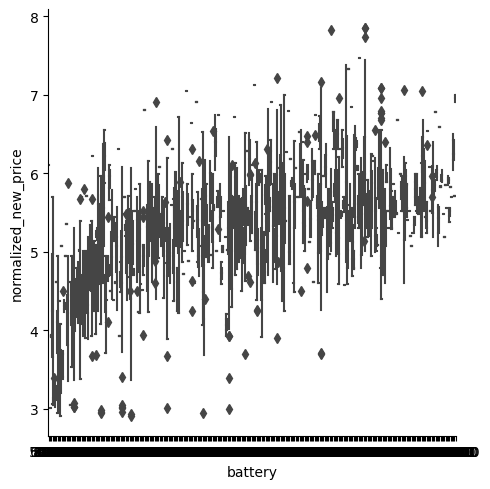

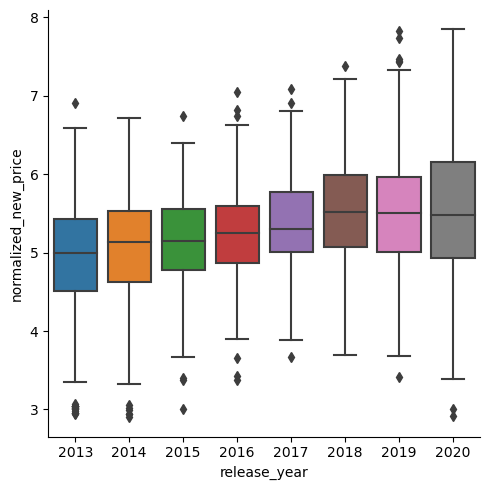

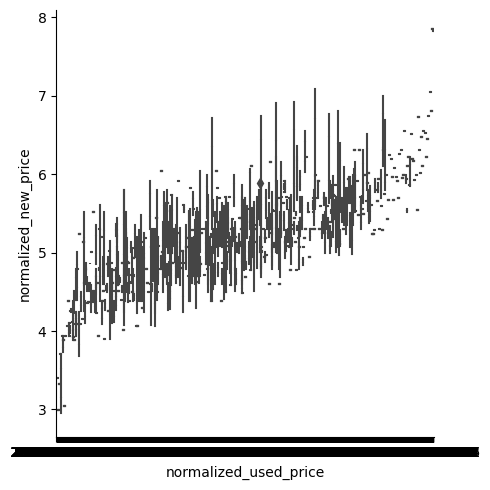

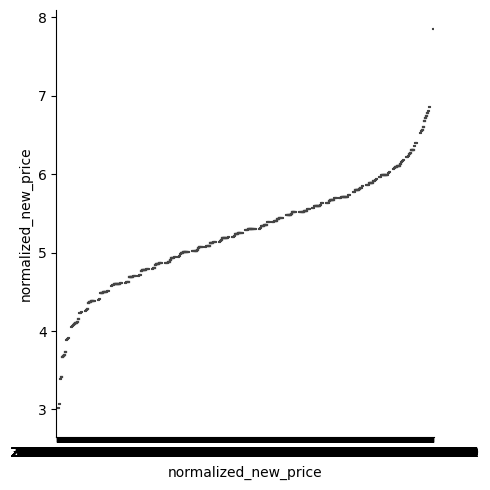

In [24]:
 for var in categorical_data:
    sb.catplot(data=categorical_data, x=var, y="normalized_new_price", kind="box")

<AxesSubplot:xlabel='rear_camera_mp', ylabel='Density'>

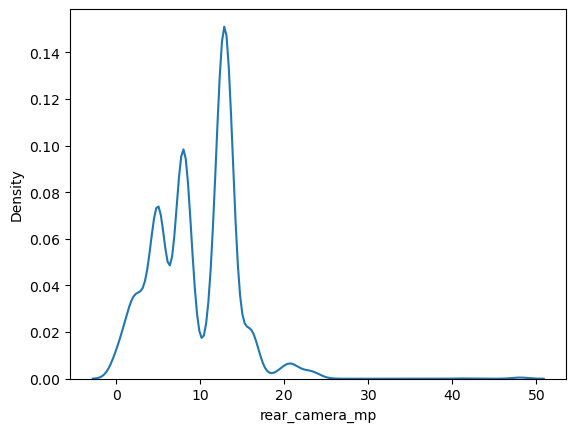

In [25]:
# Density plot of the rear camera mp
sb.kdeplot(data=data, x='rear_camera_mp')

In [26]:
# Measuring the skewness to determine if we should remove the NULL values
# Since the skew is close to 0 we can safely remove the NULL values as it is close to a normal distribution
data['rear_camera_mp'].astype(float).skew()

0.7655057967745678

In [27]:
# Finding percentage of missing values in the data
# Since the number of data that is not found is a small proportion of the total data, removing them will not significantly
# affect the accuracy of the model.
missingValues = data.isnull().sum()

rearCameraMissing = data['rear_camera_mp'].isnull().sum()
frontCameraMissing = data['front_camera_mp'].isnull().sum()
internalMemMissing = data['internal_memory'].isnull().sum()
ramMissing = data['ram'].isnull().sum()
battMissing = data['battery'].isnull().sum()
weightMissing = data['weight'].isnull().sum()

rearCamMissPercent = (rearCameraMissing/len(data['rear_camera_mp']))*100
frontCamMissPercent = (frontCameraMissing/len(data['front_camera_mp']))*100
internalMemMissPercent = (internalMemMissing/len(data['internal_memory']))*100
ramMissPercent = (ramMissing/len(data['ram']))*100
battMissPercent = (battMissing/len(data['battery']))*100
weightMissPercent = (weightMissing/len(data['weight']))*100

print("Percentage of rear camera missing: ", rearCamMissPercent, "%")
print("Percentage of front camera missing: ", frontCamMissPercent, "%")
print("Percentage of internal memory missing: ", internalMemMissPercent, "%")
print("Percentage of ram missing: ", ramMissPercent, "%")
print("Percentage of battery missing: ", battMissPercent, "%")
print("Percentage of weight missing: ", weightMissPercent, "%")

Percentage of rear camera missing:  5.182397220613781 %
Percentage of front camera missing:  0.05790387955993051 %
Percentage of internal memory missing:  0.11580775911986102 %
Percentage of ram missing:  0.11580775911986102 %
Percentage of battery missing:  0.17371163867979156 %
Percentage of weight missing:  0.2026635784597568 %


<AxesSubplot:>

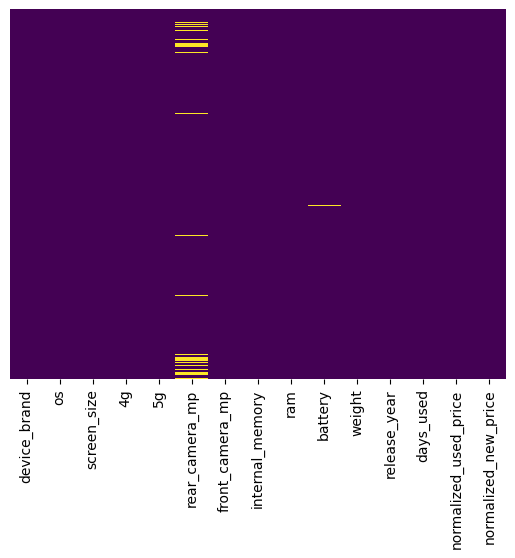

In [28]:
# Visualizing the dataset with missing data
sb.heatmap(data.isnull(),yticklabels=False,cbar=False,cmap='viridis')

<AxesSubplot:>

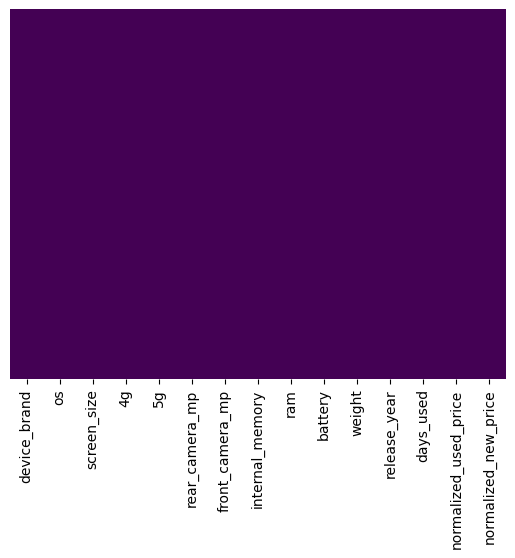

In [29]:
# Visualizing the dataset after removing the missing data
data = data.dropna()
sb.heatmap(data.isnull(),yticklabels=False,cbar=False,cmap='viridis')

In [30]:
# Checking for duplicate values
data.duplicated().sum()

0

In [31]:
data

,device_brand,os,screen_size,4g,5g,rear_camera_mp,front_camera_mp,internal_memory,ram,battery,weight,release_year,days_used,normalized_used_price,normalized_new_price
0,Honor,Android,14.50,yes,no,13.0,5.0,64.0,3.0,3020.0,146.0,2020,127,4.307572,4.715100
1,Honor,Android,17.30,yes,yes,13.0,16.0,128.0,8.0,4300.0,213.0,2020,325,5.162097,5.519018
2,Honor,Android,16.69,yes,yes,13.0,8.0,128.0,8.0,4200.0,213.0,2020,162,5.111084,5.884631
3,Honor,Android,25.50,yes,yes,13.0,8.0,64.0,6.0,7250.0,480.0,2020,345,5.135387,5.630961
4,Honor,Android,15.32,yes,no,13.0,8.0,64.0,3.0,5000.0,185.0,2020,293,4.389995,4.947837
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3447,Apple,iOS,15.27,yes,no,8.0,7.0,64.0,4.0,3110.0,194.0,2019,208,5.100902,6.287933
3450,Asus,Android,15.24,yes,no,13.0,8.0,128.0,8.0,4000.0,200.0,2018,541,5.037732,6.251538
3451,Alcatel,Android,15.80,yes,no,13.0,5.0,32.0,3.0,4000.0,165.0,2020,201,4.357350,4.528829
3452,Alcatel,Android,15.80,yes,no,13.0,5.0,32.0,2.0,4000.0,160.0,2020,149,4.349762,4.624188


In [32]:
# Encoding the categorical data into a binary form for ease of data processing
data['4g'] = data['4g'].map({'yes':1,'no':0})
data['5g'] = data['5g'].map({'yes':1,'no':0})

# Performing EDA on the data

<AxesSubplot:xlabel='4g', ylabel='normalized_used_price'>

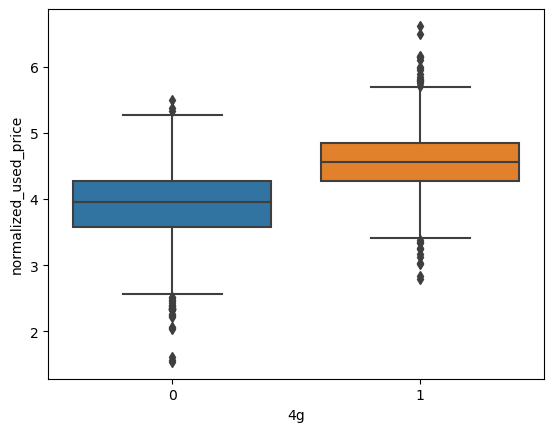

In [33]:
# Plotting the categorical data against normalised used price
sb.boxplot(data=data, x='4g', y=data['normalized_used_price'])

<AxesSubplot:xlabel='5g', ylabel='normalized_used_price'>

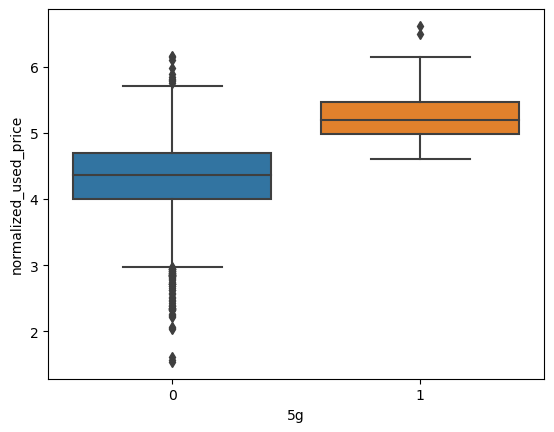

In [34]:
sb.boxplot(data=data, x='5g', y=data['normalized_used_price'])

### As seen above there is a clear difference between the boxplots of the 5g vs no 5g or 4g vs no 4g. This implies that 4g and 5g data can be used as predictors for predicting the trend of used phone price.

## Plotting Pairplot to investigate non-linear relationships, as well as possible clustering of data


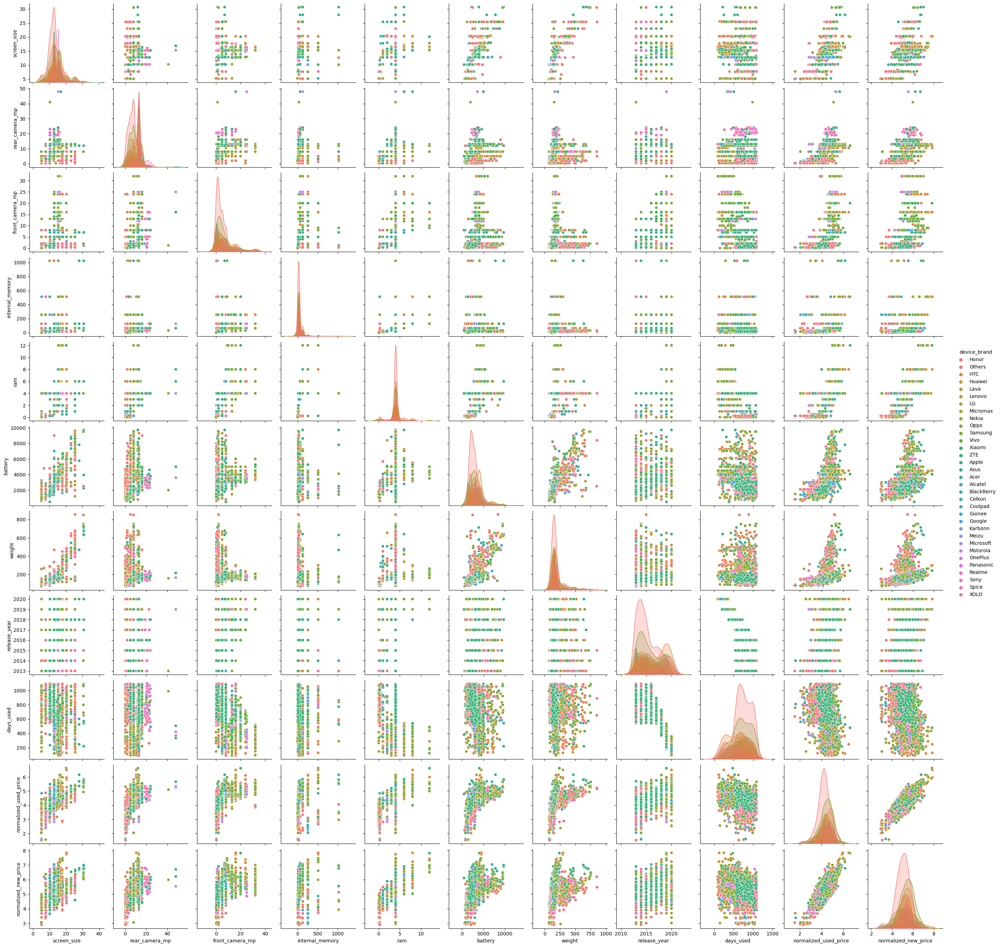

In [35]:
pairplotData = data.drop(columns=['4g', '5g'])
sb.pairplot(data=pairplotData, hue='device_brand')

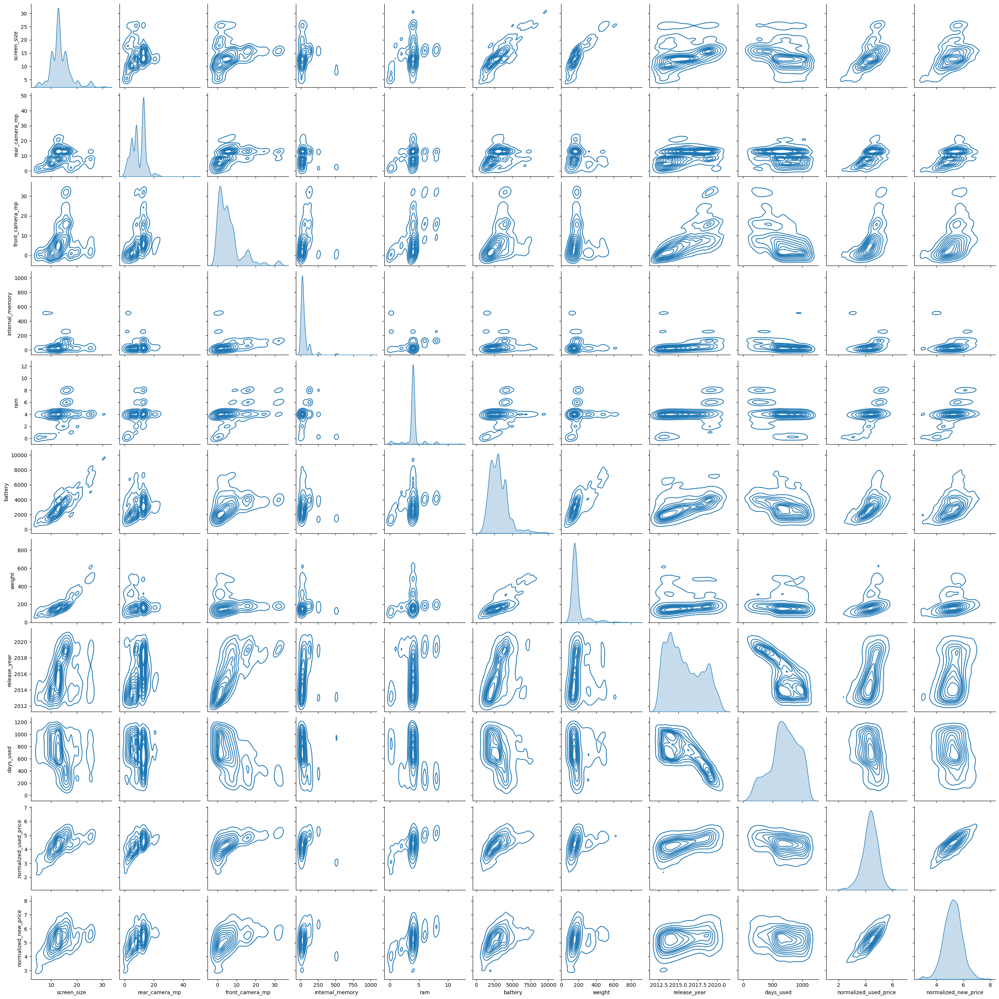

In [36]:
pairplotData = data.drop(columns=['4g', '5g'])
sb.pairplot(data=pairplotData, kind='kde')

### As seen in the hue of the pairplots, the screen size could be used as a predictor in predicting the normalized used price, since the data seems to be segregated into clusters of similar screen size and similar normalized used price. Perhaps we can use it to determine if the phones are "expensive". Though that requires some more definitions

### Weight and battery can be studied together with screen size to give a prediction on the price range of the used phones

### Days used and rear camera mp can also be used together to determine the price range of the used phones. The same can be observed with front camera mp as well

### Release year and days used can also be used together as well

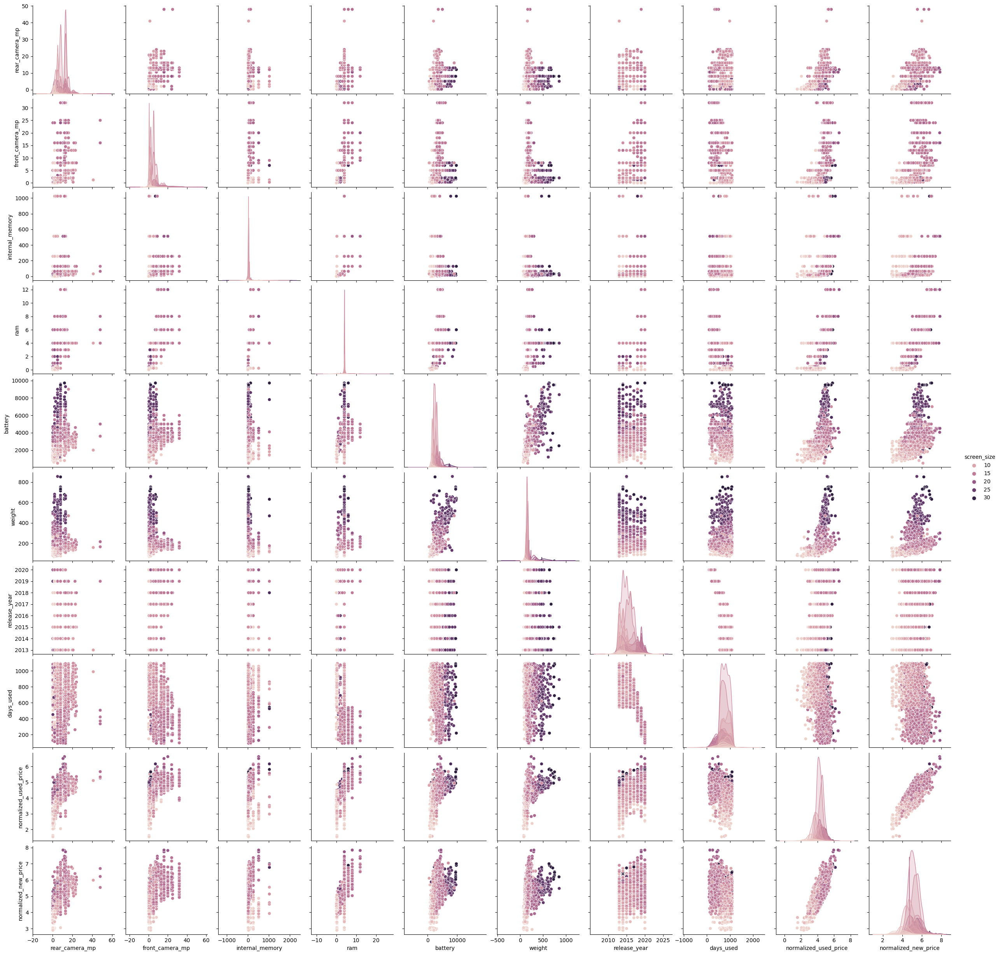

In [37]:
sb.pairplot(data=pairplotData, hue='screen_size')

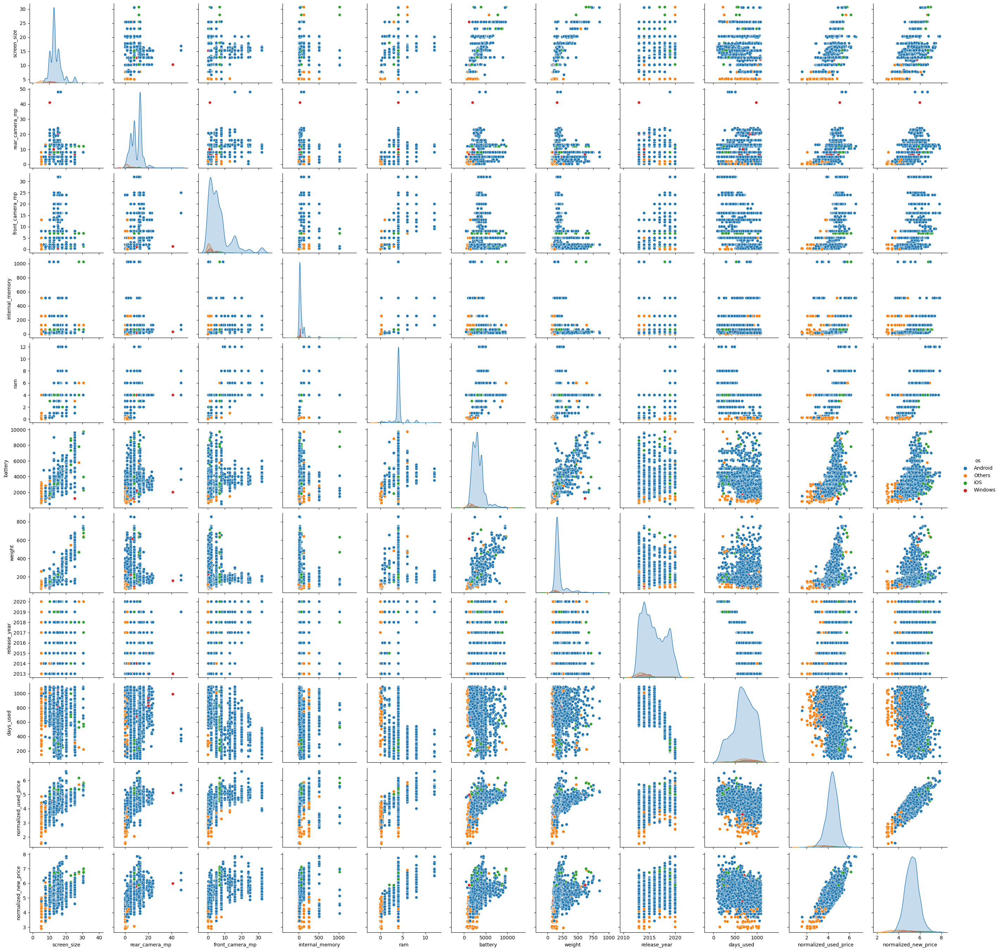

In [38]:
sb.pairplot(data=pairplotData, hue='os')

In [39]:
# sb.pairplot(data=pairplotData, hue='4g')

In [40]:
# sb.pairplot(data=pairplotData, hue='5g')

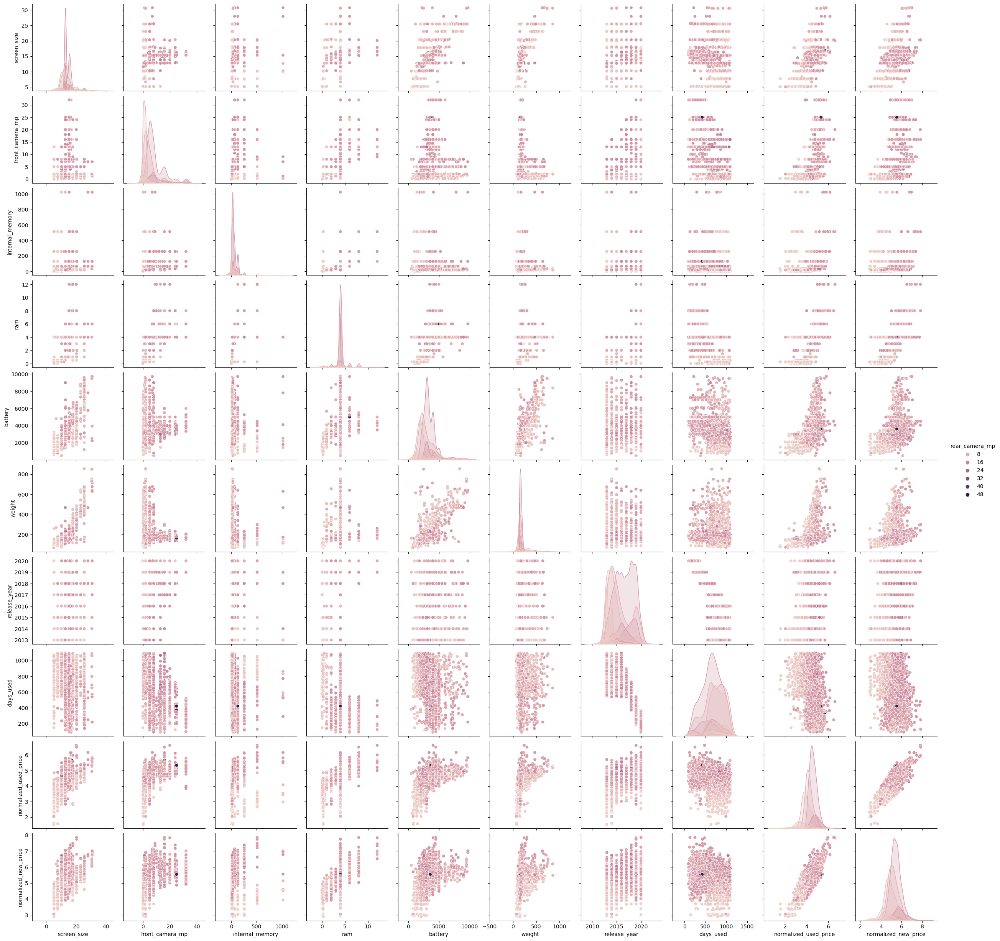

In [41]:
sb.pairplot(data=pairplotData, hue='rear_camera_mp')

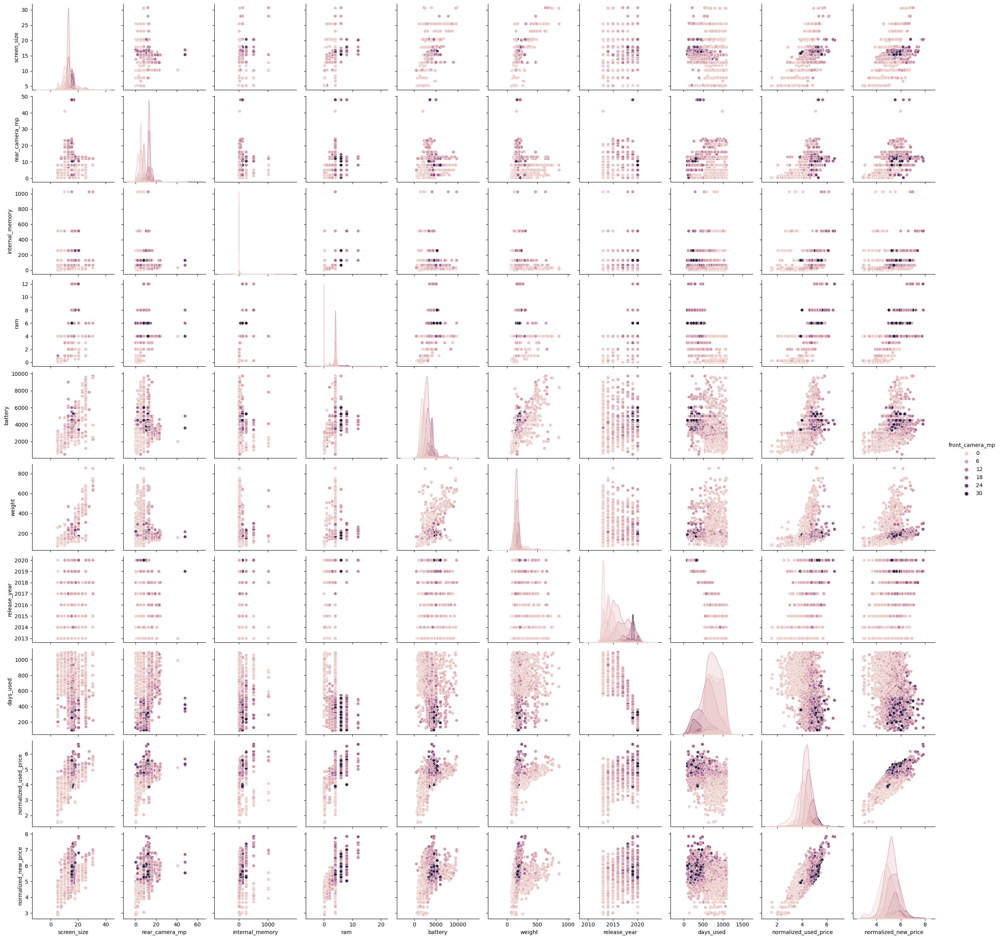

In [42]:
sb.pairplot(data=pairplotData, hue='front_camera_mp')

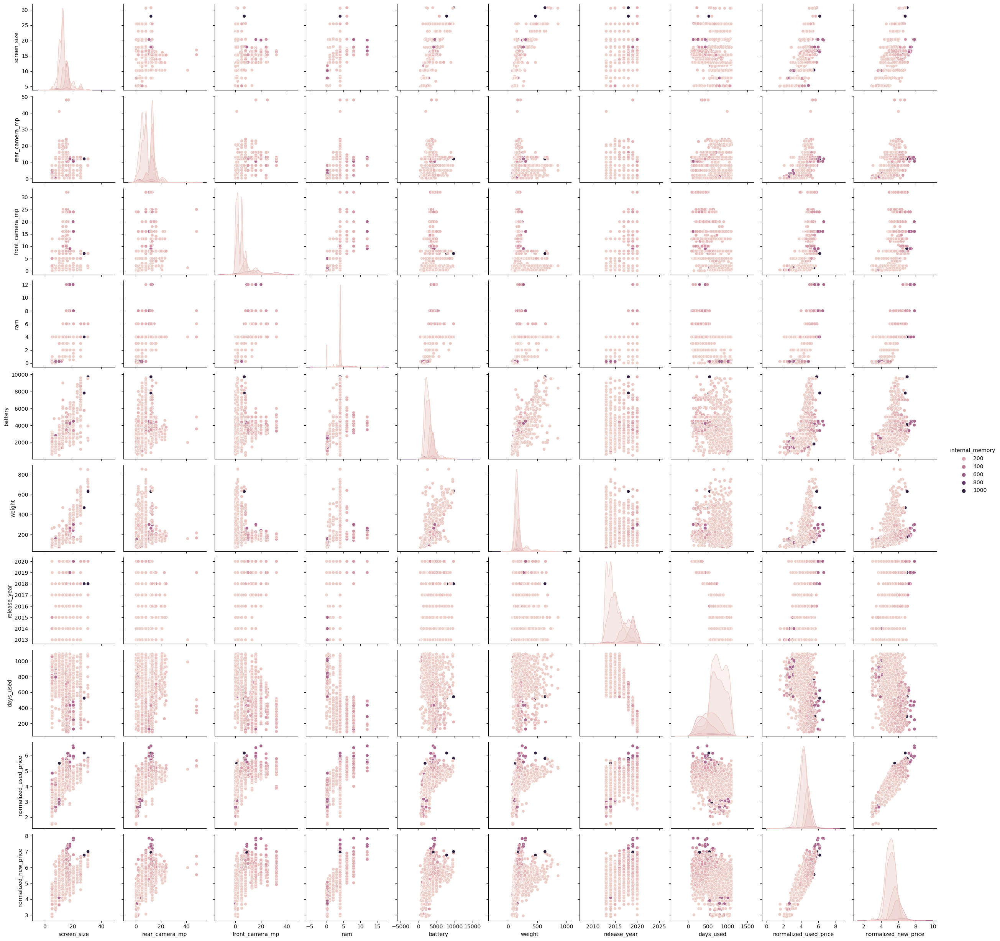

In [43]:
sb.pairplot(data=pairplotData, hue='internal_memory')

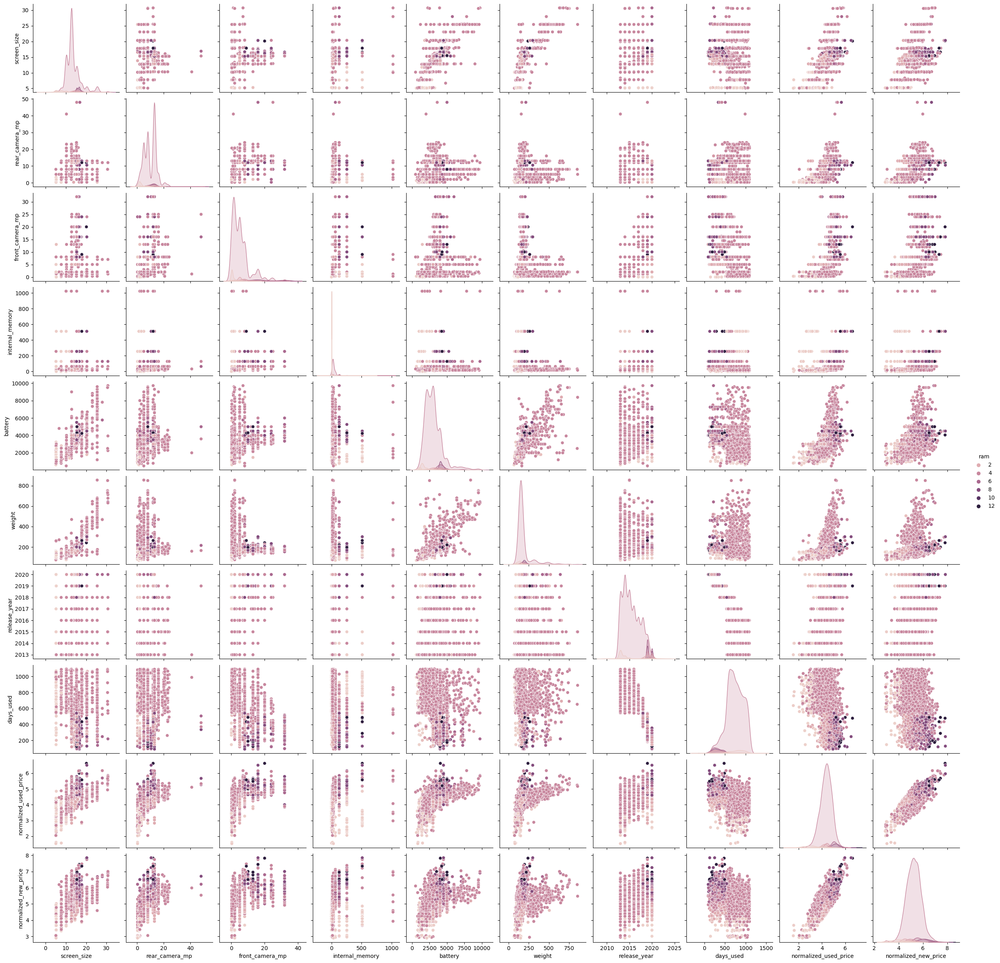

In [44]:
sb.pairplot(data=pairplotData, hue='ram')

In [45]:
# sb.pairplot(data=pairplotData, hue='battery')

In [46]:
# sb.pairplot(data=pairplotData, hue='weight')

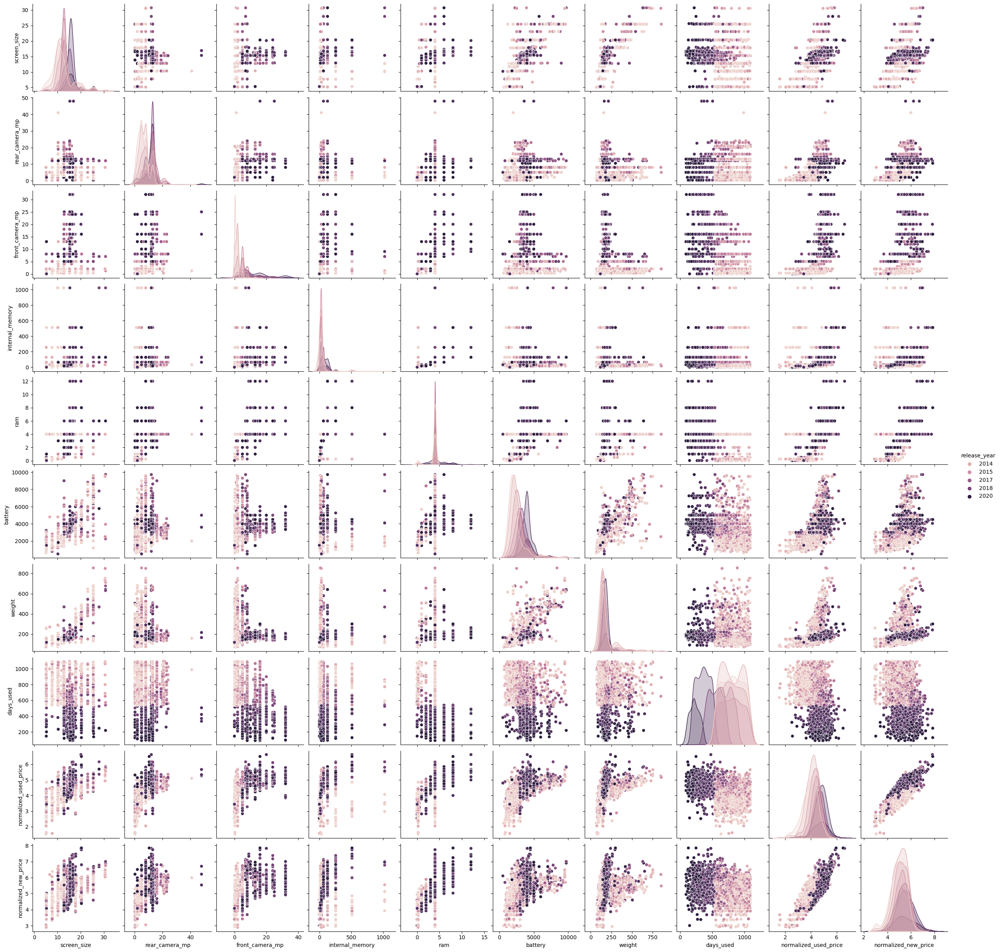

In [47]:
sb.pairplot(data=pairplotData, hue='release_year')

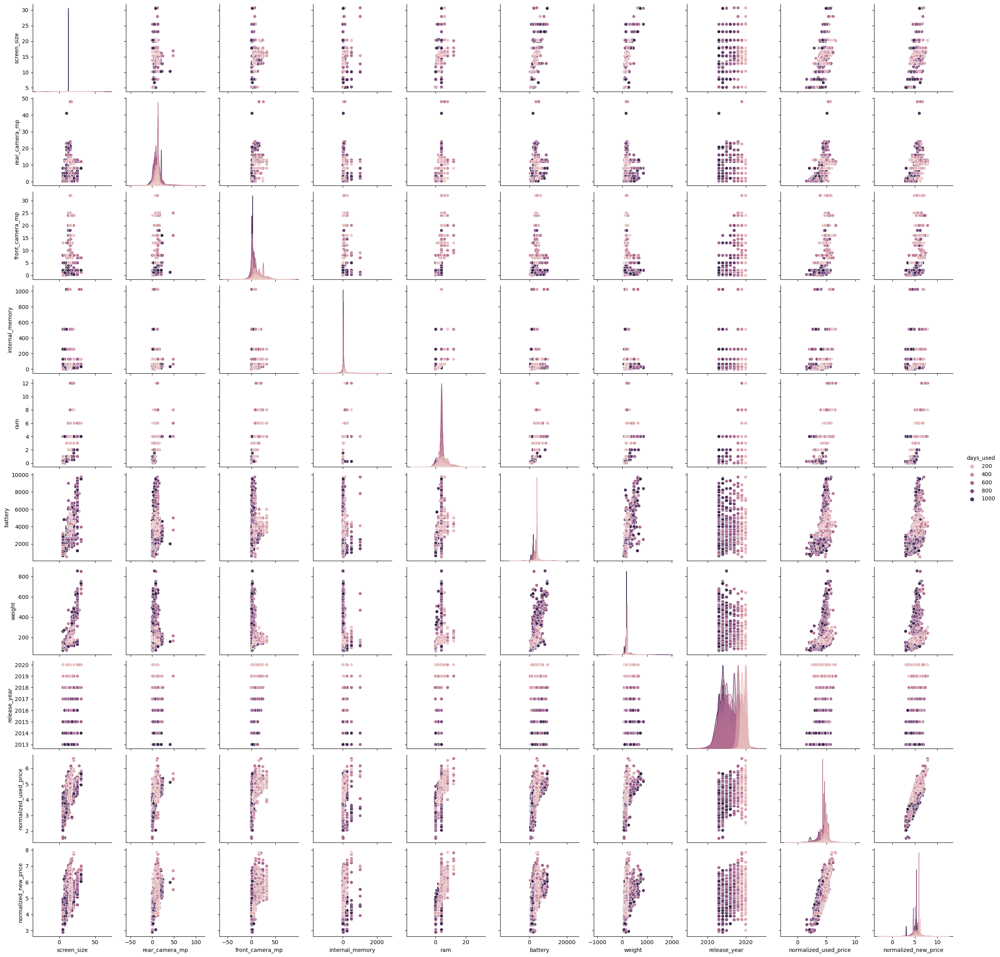

In [48]:
sb.pairplot(data=pairplotData, hue='days_used')

<AxesSubplot:>

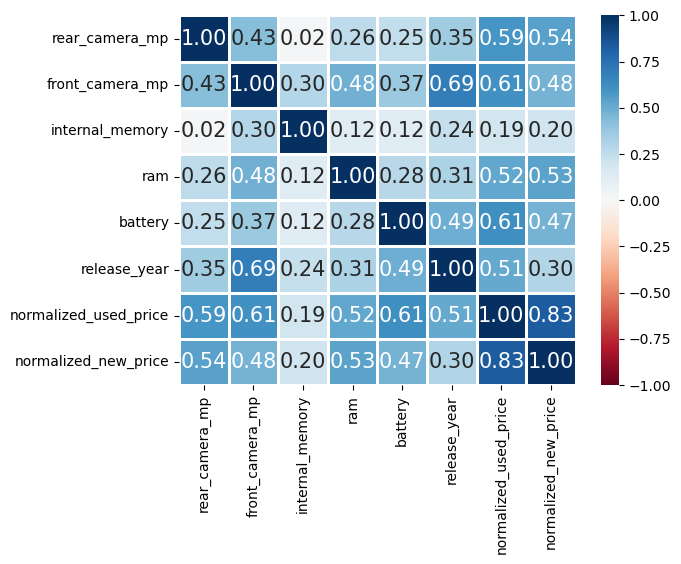

In [49]:
sb.heatmap(categorical_data.corr(), vmin = -1, vmax = 1, linewidths = 1,
           annot = True, fmt = ".2f", annot_kws = {"size": 15}, cmap = "RdBu")

## Linear Regression with outliers as well as with R^2 and MSE

Intercept of Regression 	: b =  [0.60843774]
Coefficients of Regression 	: a =  [[0.71539802]]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.6894288302932818
Mean Squared Error (MSE) 	: 0.10299179605506956

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.7007928249829605
Mean Squared Error (MSE) 	: 0.10517507956592999

Skewness of data:  -0.519105480790038


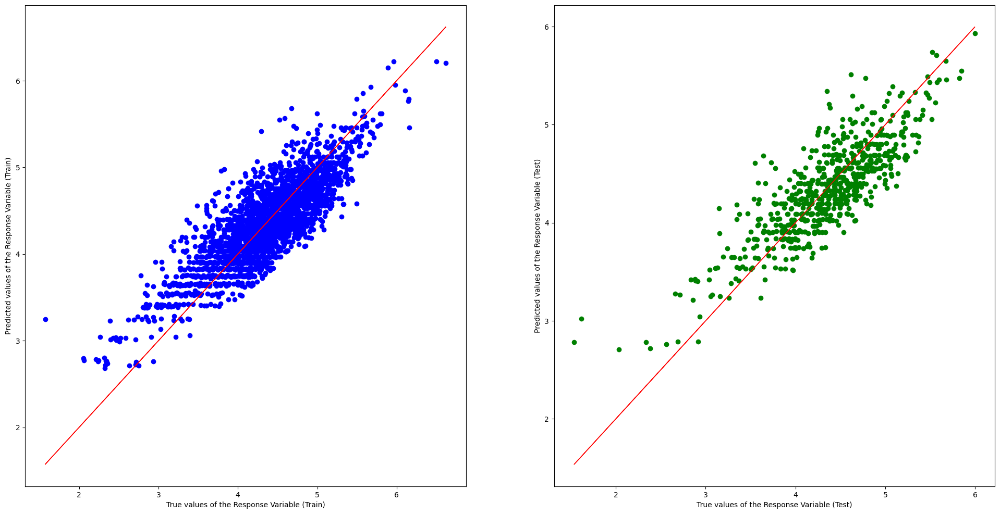

In [50]:
# Import essential models and functions from sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Recall the Total-HP Dataset
normUsedPrice = pd.DataFrame(pd.DataFrame(data['normalized_used_price']))   # Response
newPrice = pd.DataFrame(pd.DataFrame(data['normalized_new_price']))         # Predictor

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(newPrice, normUsedPrice, test_size = 0.2)

# Linear Regression using Train Data
linreg = LinearRegression()         # create the linear regression object
linreg.fit(X_train, y_train)        # train the linear regression model

# Coefficients of the Linear Regression line
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Predict Total values corresponding to HP
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
print()

# Checking skewness of data
print("Skewness of data: ", data['normalized_used_price'].skew())

# Plot the Predictions vs the True values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_train_pred, color = "blue")

axes[0].plot(y_train.squeeze(), y_train.squeeze(), 'r-', linewidth = 1)

axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[1].scatter(y_test, y_test_pred, color = "green")

axes[1].plot(y_test.squeeze(), y_test.squeeze(), 'r-', linewidth = 1)
# 
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

<AxesSubplot:xlabel='normalized_used_price', ylabel='Density'>

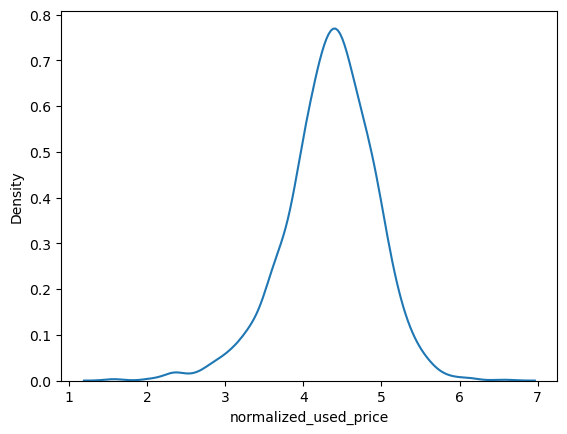

In [51]:
sb.kdeplot(data=data['normalized_used_price'])

Intercept of Regression 	: b =  [3.50298455]
Coefficients of Regression 	: a =  [[0.00027231]]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.3680202108836411
Mean Squared Error (MSE) 	: 0.21478341131436687

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.3845287563423534
Mean Squared Error (MSE) 	: 0.1961203364646038



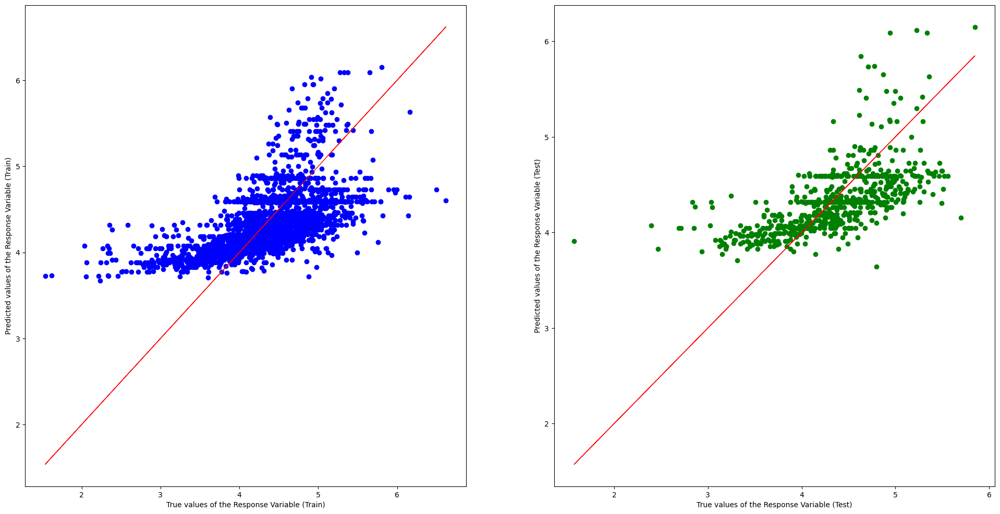

In [52]:
# Import essential models and functions from sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Recall the Total-HP Dataset
normUsedPrice = pd.DataFrame(pd.DataFrame(data['normalized_used_price']))   # Response
battery = pd.DataFrame(pd.DataFrame(data['battery']))         # Predictor

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(battery, normUsedPrice, test_size = 0.2)

# Linear Regression using Train Data
linreg = LinearRegression()         # create the linear regression object
linreg.fit(X_train, y_train)        # train the linear regression model

# Coefficients of the Linear Regression line
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Predict Total values corresponding to HP
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
print()

# Plot the Predictions vs the True values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_train_pred, color = "blue")

axes[0].plot(y_train.squeeze(), y_train.squeeze(), 'r-', linewidth = 1)

axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[1].scatter(y_test, y_test_pred, color = "green")

axes[1].plot(y_test.squeeze(), y_test.squeeze(), 'r-', linewidth = 1)
# 
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

Intercept of Regression 	: b =  [3.09182581]
Coefficients of Regression 	: a =  [[0.09183852]]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.37450757330159046
Mean Squared Error (MSE) 	: 0.21472031292720856

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.3481402829902386
Mean Squared Error (MSE) 	: 0.19876059688922798



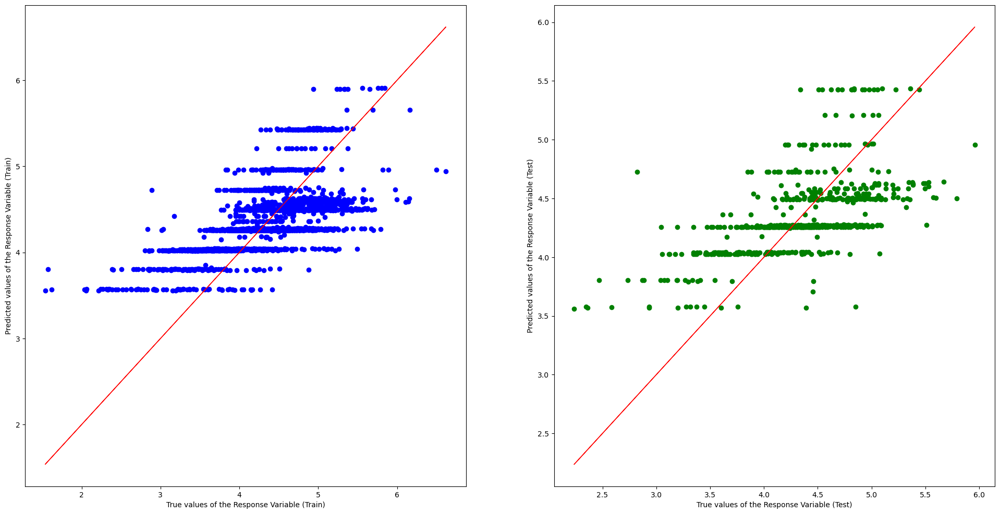

In [53]:
# Import essential models and functions from sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Recall the Total-HP Dataset
normUsedPrice = pd.DataFrame(pd.DataFrame(data['normalized_used_price']))   # Response
screenSize = pd.DataFrame(pd.DataFrame(data['screen_size']))         # Predictor

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(screenSize, normUsedPrice, test_size = 0.2)

# Linear Regression using Train Data
linreg = LinearRegression()         # create the linear regression object
linreg.fit(X_train, y_train)        # train the linear regression model

# Coefficients of the Linear Regression line
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Predict Total values corresponding to HP
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
print()

# Plot the Predictions vs the True values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_train_pred, color = "blue")

axes[0].plot(y_train.squeeze(), y_train.squeeze(), 'r-', linewidth = 1)

axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[1].scatter(y_test, y_test_pred, color = "green")

axes[1].plot(y_test.squeeze(), y_test.squeeze(), 'r-', linewidth = 1)
# 
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

Intercept of Regression 	: b =  [3.68516175]
Coefficients of Regression 	: a =  [[0.0697506]]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.3381587295354338
Mean Squared Error (MSE) 	: 0.21826956537897485

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.35187431128581614
Mean Squared Error (MSE) 	: 0.2320083482576894



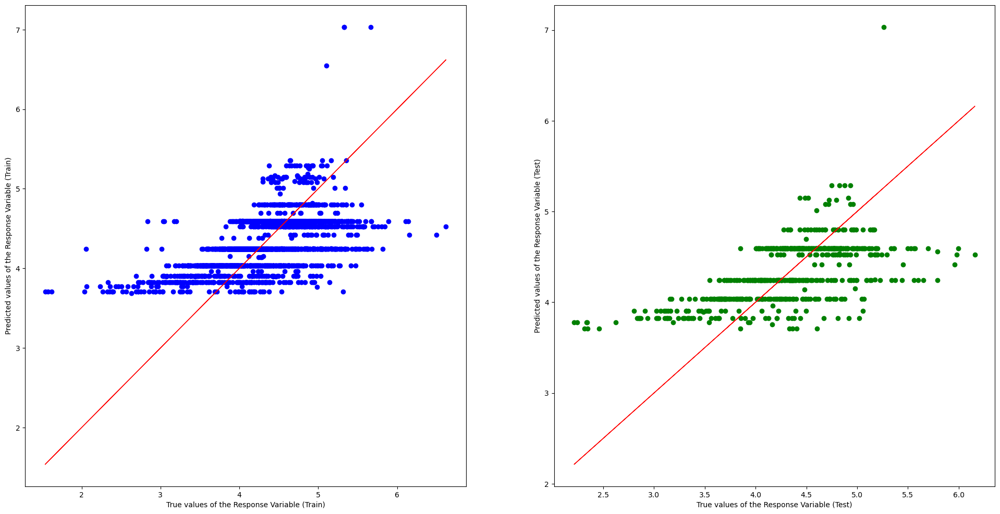

In [54]:
# Import essential models and functions from sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Recall the Total-HP Dataset
normUsedPrice = pd.DataFrame(pd.DataFrame(data['normalized_used_price']))   # Response
rearCameraMP = pd.DataFrame(pd.DataFrame(data['rear_camera_mp']))         # Predictor

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(rearCameraMP, normUsedPrice, test_size = 0.2)

# Linear Regression using Train Data
linreg = LinearRegression()         # create the linear regression object
linreg.fit(X_train, y_train)        # train the linear regression model

# Coefficients of the Linear Regression line
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Predict Total values corresponding to HP
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
print()

# Plot the Predictions vs the True values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_train_pred, color = "blue")

axes[0].plot(y_train.squeeze(), y_train.squeeze(), 'r-', linewidth = 1)

axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[1].scatter(y_test, y_test_pred, color = "green")

axes[1].plot(y_test.squeeze(), y_test.squeeze(), 'r-', linewidth = 1)
# 
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

Intercept of Regression 	: b =  [4.03220895]
Coefficients of Regression 	: a =  [[0.05109243]]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.3415674921681381
Mean Squared Error (MSE) 	: 0.2166459822055343

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.37043634245130497
Mean Squared Error (MSE) 	: 0.22784435593059904



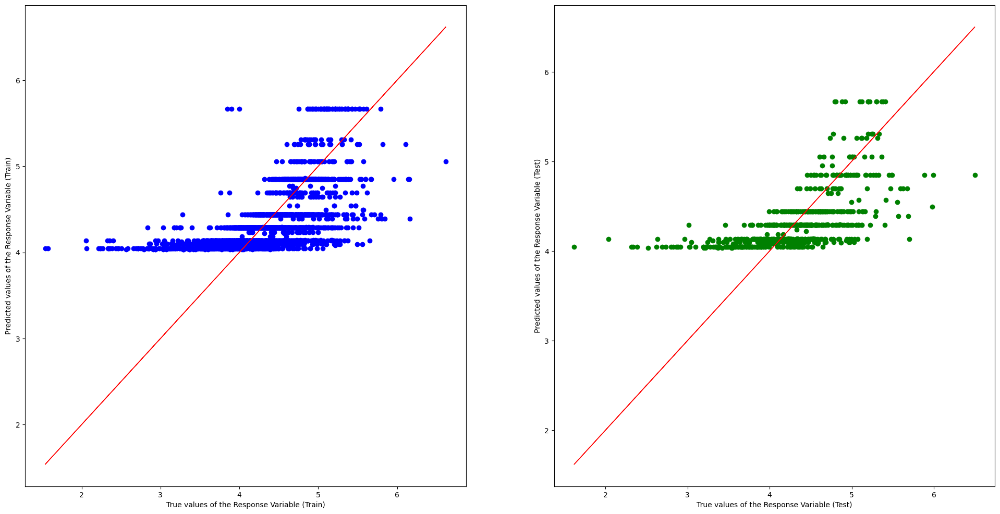

In [55]:
# Import essential models and functions from sklearn
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

# Recall the Total-HP Dataset
normUsedPrice = pd.DataFrame(pd.DataFrame(data['normalized_used_price']))   # Response
frontCameraMP = pd.DataFrame(pd.DataFrame(data['front_camera_mp']))         # Predictor

# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(frontCameraMP, normUsedPrice, test_size = 0.2)

# Linear Regression using Train Data
linreg = LinearRegression()         # create the linear regression object
linreg.fit(X_train, y_train)        # train the linear regression model

# Coefficients of the Linear Regression line
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Predict Total values corresponding to HP
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

# Check the Goodness of Fit (on Train Data)
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()

# Check the Goodness of Fit (on Test Data)
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
print()

# Plot the Predictions vs the True values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_train_pred, color = "blue")

axes[0].plot(y_train.squeeze(), y_train.squeeze(), 'r-', linewidth = 1)

axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[1].scatter(y_test, y_test_pred, color = "green")

axes[1].plot(y_test.squeeze(), y_test.squeeze(), 'r-', linewidth = 1)
# 
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()